In [1]:
import sqlite3
from tqdm import tqdm
import os
import yaml
import datetime
import matplotlib.pyplot as plt

import series
import util

In [2]:
TIME_FORMAT = "%Y-%m-%d %H:%M:%S.%f"
TIME_FORMAT_SHORT = "%Y-%m-%d %Hh"
start_date = datetime.datetime.strptime("2024-08-01 00:00:00.000000", TIME_FORMAT)
end_date = datetime.datetime.strptime("2024-09-01 00:00:00.000000", TIME_FORMAT)
start_short = datetime.datetime.strptime("2024-09-01 00:00:00.000000", TIME_FORMAT)
end_short = datetime.datetime.strptime("2024-09-07 00:00:00.000000", TIME_FORMAT)

In [3]:
mappings = dict()
for file in os.scandir('../mappings'):
    if not file.name.endswith('.yaml'):
        continue
    with open(file, 'r') as fin:
        obj = yaml.safe_load(fin)
        mappings.update(util.update_names(obj))
mappings_extra = dict()
for file in os.scandir('../mappings/other'):
    with open(file, 'r') as fin:
        obj = yaml.safe_load(fin)
        mappings_extra.update(obj)
util.set_mappings(mappings, mappings_extra)

In [4]:
conn = sqlite3.connect('diff_v2.sqlite3')
cur = conn.cursor()

#cur.execute('SELECT Timestamp, Device, ObjectType, ObjectId, Property, Value FROM FullValues ORDER BY Timestamp, Device, ObjectType, ObjectId, Property')
#data = cur.fetchall()
cur.execute('SELECT DISTINCT Device, ObjectType, ObjectId, Property FROM FullValues ORDER BY Device, ObjectType, ObjectId, Property')
features = cur.fetchall()
cur.execute('SELECT * FROM ListSeries WHERE Color != "black" ORDER BY Feature, Timestamp, ItemId')
list_data = cur.fetchall()

conn.close()

In [7]:
"""
types = dict()
for elem in features:
    _, obj, _, prop = elem
    if prop == 'presentValue':
        continue
    if prop in mappings[obj]:
        typ = mappings[obj][prop]['Type']
        if type(typ) == dict and typ['Name'] in ['list', 'array', 'object', 'object ref']:
            typ = typ['Name']
        elif typ not in ['number', 'bool', 'datetime', 'other', 'invalid']:
            print('Found type', mappings[obj][prop]['Type'])
            print('Feature is', elem)
            continue
        types[elem] = typ
"""

print('Loading fast_fetch', flush=True)
series.load_fast(file='series_full.pickle')
print('Loading done', flush=True)

Loading fast_fetch
Loading done


In [8]:
lists = dict()
feature_list = dict()
snapshot = []
last_key = None
last_time = None
for i, elem in enumerate(list_data):
    key, timestamp, ind, value, color = elem
    key = key.split(':')
    key = (key[0], key[1], int(key[2]), key[3])
    if timestamp != last_time:
        if last_time != None:
            feature_list[last_time] = snapshot
            snapshot = []
        last_time = timestamp
    if key != last_key:
        if last_key != None:
            lists[last_key] = feature_list
            feature_list = dict()
        last_key = key
    snapshot.append((value, color))
feature_list[last_time] = snapshot
lists[last_key] = feature_list

IndexError: list index out of range

In [18]:
def extra_diff(typ, lst1, lst2):
    res = 0
    keep = [True] * len(lst2)
    for elem in lst1:
        inverse_color = 'red' if elem[1] == 'green' else 'green'
        first = elem[0]
        if first == '<NULL>':
            first = None
        found = False
        for i in range(len(lst2)):
            if not keep[i]:
                continue
            if lst2[i][1] != inverse_color:
                continue
            second = lst2[i][0]
            if second == '<NULL>':
                second = None
            if util.compare(typ['Element Type'], first, second):
                keep[i] = False
                found = True
                break
        if found:
            res += 1
    return res

In [52]:
counts = []
for key in lists:
    feat_list = lists[key]
    count = 0
    times = list(feat_list.keys())
    for i in range(len(times) - 1):
        time_prev = times[i]
        time_curr = times[i + 1]
        prev = feat_list[time_prev]
        curr = feat_list[time_curr]
        count += extra_diff(mappings[key[1]][key[3]]['Type'], prev, curr)
    counts.append(count)

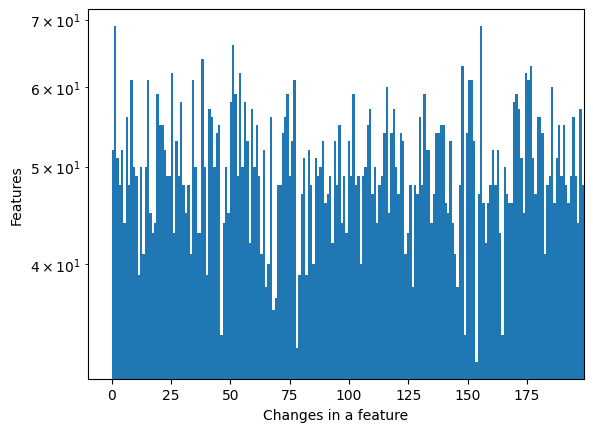

In [34]:
import random

random.seed(179)
counts2 = [random.randrange(200) for i in range(10000)]
#counts2 += [0] * int(1e6)
plt.hist(counts2, bins=200)
plt.gca().set_xlim((-9.950000000000001, 199))#208.95))
#plt.gca().set_ylim((0.0, 2923293.45))
plt.yscale('log')
plt.xlabel('Changes in a feature')
plt.ylabel('Features')
plt.show()

In [10]:
TIME_FORMAT = "%Y-%m-%d %H:%M:%S.%f"
MIN_DELTA = 7200     # 2 hours

counts = []
for feat in tqdm(features):
    _, obj, _, prop = feat
    if prop in mappings[obj]:
        typ = mappings[obj][prop]['Type']
        if type(typ) == dict and typ['Name'] == 'list':
            continue
    try:
        ser = series.fast_fetch_series(feat)
    except Exception as e:
        print('Fail:', feat)
        print(e)
        continue
    count = 0
    for i in range(len(ser) - 1):
        time1 = datetime.datetime.strptime(ser[i][0], TIME_FORMAT)
        time2 = datetime.datetime.strptime(ser[i + 1][0], TIME_FORMAT)
        if (time2 - time1).total_seconds() < MIN_DELTA:
            count += 1
    counts.append(count)

 53%|████████████████████████████████████▌                                | 2952263/5574370 [04:21<01:04, 40369.14it/s]

Fail: ('192.168.66.11', 'device', 110000, 'applicationSoftwareVersion')
('192.168.66.11', 'device', 110000, 'applicationSoftwareVersion')
Fail: ('192.168.66.11', 'device', 110000, 'backupFailureTimeout')
('192.168.66.11', 'device', 110000, 'backupFailureTimeout')
Fail: ('192.168.66.11', 'device', 110000, 'daylightSavingsStatus')
('192.168.66.11', 'device', 110000, 'daylightSavingsStatus')
Fail: ('192.168.66.11', 'device', 110000, 'description')
('192.168.66.11', 'device', 110000, 'description')
Fail: ('192.168.66.11', 'device', 110000, 'firmwareRevision')
('192.168.66.11', 'device', 110000, 'firmwareRevision')
Fail: ('192.168.66.11', 'device', 110000, 'location')
('192.168.66.11', 'device', 110000, 'location')
Fail: ('192.168.66.11', 'device', 110000, 'maxSegmentsAccepted')
('192.168.66.11', 'device', 110000, 'maxSegmentsAccepted')
Fail: ('192.168.66.11', 'device', 110000, 'numberOfApduRetries')
('192.168.66.11', 'device', 110000, 'numberOfApduRetries')
Fail: ('192.168.66.11', 'device'

 54%|████████████████████████████████████▉                                | 2984397/5574370 [04:21<00:33, 77463.90it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 59%|███████████████████████████████████████▊                            | 3265121/5574370 [04:24<00:22, 101268.26it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 59%|████████████████████████████████████████▏                           | 3299169/5574370 [04:24<00:22, 1

 ('192.168.67.122', 'binaryValue', 33, 'statusFlags')
('192.168.67.122', 'binaryValue', 33, 'statusFlags')
Fail: ('192.168.67.122', 'binaryValue', 33, 'timeDelay')
('192.168.67.122', 'binaryValue', 33, 'timeDelay')
Fail: ('192.168.67.122', 'binaryValue', 34, 'activeText')
('192.168.67.122', 'binaryValue', 34, 'activeText')
Fail: ('192.168.67.122', 'binaryValue', 34, 'alarmValue')
('192.168.67.122', 'binaryValue', 34, 'alarmValue')
Fail: ('192.168.67.122', 'binaryValue', 34, 'description')
('192.168.67.122', 'binaryValue', 34, 'description')
Fail: ('192.168.67.122', 'binaryValue', 34, 'eventEnable')
('192.168.67.122', 'binaryValue', 34, 'eventEnable')
Fail: ('192.168.67.122', 'binaryValue', 34, 'feedbackValue')
('192.168.67.122', 'binaryValue', 34, 'feedbackValue')
Fail: ('192.168.67.122', 'binaryValue', 34, 'inactiveText')
('192.168.67.122', 'binaryValue', 34, 'inactiveText')
Fail: ('192.168.67.122', 'binaryValue', 34, 'minimumOffTime')
('192.168.67.122', 'binaryValue', 34, 'minimumOff

 61%|█████████████████████████████████████████▊                           | 3375893/5574370 [04:25<00:22, 98279.49it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 61%|██████████████████████████████████████████▏                          | 3404543/5574370 [04:26<00:25, 85030.61it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 61%|██████████████████████████████████████████▎                          | 3422416/5574370 [04:26<00:25, 


Fail: ('192.168.67.148', 'multiStateValue', 130, 'priorityArray')
('192.168.67.148', 'multiStateValue', 130, 'priorityArray')
Fail: ('192.168.67.148', 'multiStateValue', 130, 'reliability')
('192.168.67.148', 'multiStateValue', 130, 'reliability')
Fail: ('192.168.67.148', 'multiStateValue', 130, 'relinquishDefault')
('192.168.67.148', 'multiStateValue', 130, 'relinquishDefault')
Fail: ('192.168.67.148', 'multiStateValue', 130, 'statusFlags')
('192.168.67.148', 'multiStateValue', 130, 'statusFlags')
Fail: ('192.168.67.148', 'multiStateValue', 130, 'timeDelay')
('192.168.67.148', 'multiStateValue', 130, 'timeDelay')
Fail: ('192.168.67.148', 'multiStateValue', 131, 'description')
('192.168.67.148', 'multiStateValue', 131, 'description')
Fail: ('192.168.67.148', 'multiStateValue', 131, 'eventEnable')
('192.168.67.148', 'multiStateValue', 131, 'eventEnable')
Fail: ('192.168.67.148', 'multiStateValue', 131, 'notificationClass')
('192.168.67.148', 'multiStateValue', 131, 'notificationClass')

 68%|██████████████████████████████████████████████▋                      | 3773038/5574370 [04:29<00:23, 77617.29it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 68%|██████████████████████████████████████████████▉                      | 3790623/5574370 [04:30<00:22, 79056.12it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 69%|███████████████████████████████████████████████▎                     | 3819588/5574370 [04:30<00:20, 

('192.168.67.164', 'analogValue', 655, 'deadband')
('192.168.67.164', 'analogValue', 655, 'deadband')
Fail: ('192.168.67.164', 'analogValue', 655, 'description')
('192.168.67.164', 'analogValue', 655, 'description')
Fail: ('192.168.67.164', 'analogValue', 655, 'eventEnable')
('192.168.67.164', 'analogValue', 655, 'eventEnable')
Fail: ('192.168.67.164', 'analogValue', 655, 'highLimit')
('192.168.67.164', 'analogValue', 655, 'highLimit')
Fail: ('192.168.67.164', 'analogValue', 655, 'limitEnable')
('192.168.67.164', 'analogValue', 655, 'limitEnable')
Fail: ('192.168.67.164', 'analogValue', 655, 'lowLimit')
('192.168.67.164', 'analogValue', 655, 'lowLimit')
Fail: ('192.168.67.164', 'analogValue', 655, 'notificationClass')
('192.168.67.164', 'analogValue', 655, 'notificationClass')
Fail: ('192.168.67.164', 'analogValue', 655, 'notifyType')
('192.168.67.164', 'analogValue', 655, 'notifyType')
Fail: ('192.168.67.164', 'analogValue', 655, 'objectName')
('192.168.67.164', 'analogValue', 655, 'o

 74%|██████████████████████████████████████████████████                  | 4102354/5574370 [04:33<00:14, 104974.31it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 79%|██████████████████████████████████████████████████████              | 4428323/5574370 [04:36<00:09, 119763.60it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 80%|██████████████████████████████████████████████████████▎             | 4453695/5574370 [04:36<00:09, 1

('192.168.67.30', 'analogValue', 242, 'reliability')
('192.168.67.30', 'analogValue', 242, 'reliability')
Fail: ('192.168.67.30', 'analogValue', 242, 'relinquishDefault')
('192.168.67.30', 'analogValue', 242, 'relinquishDefault')
Fail: ('192.168.67.30', 'analogValue', 242, 'statusFlags')
('192.168.67.30', 'analogValue', 242, 'statusFlags')
Fail: ('192.168.67.30', 'analogValue', 242, 'timeDelay')
('192.168.67.30', 'analogValue', 242, 'timeDelay')
Fail: ('192.168.67.30', 'analogValue', 242, 'units')
('192.168.67.30', 'analogValue', 242, 'units')
Fail: ('192.168.67.30', 'analogValue', 243, 'covIncrement')
('192.168.67.30', 'analogValue', 243, 'covIncrement')
Fail: ('192.168.67.30', 'analogValue', 243, 'deadband')
('192.168.67.30', 'analogValue', 243, 'deadband')
Fail: ('192.168.67.30', 'analogValue', 243, 'description')
('192.168.67.30', 'analogValue', 243, 'description')
Fail: ('192.168.67.30', 'analogValue', 243, 'eventEnable')
('192.168.67.30', 'analogValue', 243, 'eventEnable')
Fail: 

 84%|█████████████████████████████████████████████████████████▏          | 4684631/5574370 [04:38<00:08, 104312.73it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 90%|█████████████████████████████████████████████████████████████▎      | 5031135/5574370 [04:41<00:05, 106296.52it/s]

 ('192.168.67.61', 'analogValue', 582, 'deadband')
('192.168.67.61', 'analogValue', 582, 'deadband')
Fail: ('192.168.67.61', 'analogValue', 582, 'description')
('192.168.67.61', 'analogValue', 582, 'description')
Fail: ('192.168.67.61', 'analogValue', 582, 'eventEnable')
('192.168.67.61', 'analogValue', 582, 'eventEnable')
Fail: ('192.168.67.61', 'analogValue', 582, 'highLimit')
('192.168.67.61', 'analogValue', 582, 'highLimit')
Fail: ('192.168.67.61', 'analogValue', 582, 'limitEnable')
('192.168.67.61', 'analogValue', 582, 'limitEnable')
Fail: ('192.168.67.61', 'analogValue', 582, 'lowLimit')
('192.168.67.61', 'analogValue', 582, 'lowLimit')
Fail: ('192.168.67.61', 'analogValue', 582, 'notificationClass')
('192.168.67.61', 'analogValue', 582, 'notificationClass')
Fail: ('192.168.67.61', 'analogValue', 582, 'notifyType')
('192.168.67.61', 'analogValue', 582, 'notifyType')
Fail: ('192.168.67.61', 'analogValue', 582, 'objectName')
('192.168.67.61', 'analogValue', 582, 'objectName')
Fail:

 91%|█████████████████████████████████████████████████████████████▋      | 5056623/5574370 [04:41<00:04, 110831.72it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 97%|█████████████████████████████████████████████████████████████████▉  | 5409866/5574370 [04:45<00:01, 118997.24it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 98%|██████████████████████████████████████████████████████████████████▋ | 5465361/5574370 [04:45<00:00, 1

Fail: ('192.168.67.93', 'analogValue', 229, 'notifyType')
('192.168.67.93', 'analogValue', 229, 'notifyType')
Fail: ('192.168.67.93', 'analogValue', 229, 'objectName')
('192.168.67.93', 'analogValue', 229, 'objectName')
Fail: ('192.168.67.93', 'analogValue', 229, 'outOfService')
('192.168.67.93', 'analogValue', 229, 'outOfService')
Fail: ('192.168.67.93', 'analogValue', 229, 'presentValue')
('192.168.67.93', 'analogValue', 229, 'presentValue')
Fail: ('192.168.67.93', 'analogValue', 229, 'priorityArray')
('192.168.67.93', 'analogValue', 229, 'priorityArray')
Fail: ('192.168.67.93', 'analogValue', 229, 'reliability')
('192.168.67.93', 'analogValue', 229, 'reliability')
Fail: ('192.168.67.93', 'analogValue', 229, 'relinquishDefault')
('192.168.67.93', 'analogValue', 229, 'relinquishDefault')
Fail: ('192.168.67.93', 'analogValue', 229, 'statusFlags')
('192.168.67.93', 'analogValue', 229, 'statusFlags')
Fail: ('192.168.67.93', 'analogValue', 229, 'timeDelay')
('192.168.67.93', 'analogValue'

 99%|███████████████████████████████████████████████████████████████████▎| 5516740/5574370 [04:45<00:00, 114738.61it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [55]:
import numpy as np

cnts = np.array(counts)

In [63]:
vals, nums = np.unique(cnts, return_counts = True)
dict(zip(vals, nums))
print(np.count_nonzero(cnts))
nonzeros = cnts[cnts != 0]
print(np.count_nonzero(nonzeros - 1))
print(np.quantile(cnts, [0.25, 0.5, 0.75]))
print(np.quantile(nonzeros, [0.25, 0.5, 0.75]))

30414
28355
[0. 0. 0.]
[ 11.  21. 104.]


In [65]:
30414/2812631

0.010813363004247624

In [22]:
def get_diff(typ, lst1, lst2, show_old):
    i1 = 0
    i2 = 0
    diff = []
    ln1 = len(lst1)
    ln2 = len(lst2)
    
    found_at = [False] * ln1
    for i, elem in enumerate(lst2):
        found = False
        for j, elem2 in enumerate(lst1):
            if found_at[j]:
                continue
            if util.compare(typ['Element Type'], elem, elem2):
                found = True
                found_at[j] = True
                break
        if found:
            if show_old:
                diff.append((elem, 'black'))
        else:
            diff.append((elem, 'green'))
    
    found_at = [False] * ln2
    for i, elem in enumerate(lst1):
        found = False
        for j, elem2 in enumerate(lst2):
            if found_at[j]:
                continue
            if util.compare(typ['Element Type'], elem, elem2):
                found = True
                found_at[j] = True
                break
        if not found:
            diff.append((elem, 'red'))
    return diff

def list_diff(key):
    _, obj, _, prop = key
    res = series.fast_fetch_series(key, None)
    items = []
    if len(res) == 1:
        return None
    for i, elem in enumerate(res):
        if elem[1] is None:
            items.append((elem[0], ['<NULL>']))
        else:
            items.append((elem[0], sorted(util.parse_list(elem[1]))))
    diff = [(items[0][0], list(map(lambda x: (x, 'black'), items[0][1])))]
    for i in tqdm(range(1, len(items))):
        diff.append((items[i][0], get_diff(mappings[obj][prop]['Type'], items[i - 1][1], items[i][1], False)))

    diff = list(filter(lambda x: len(x[1]) > 0, diff))
    
    conn.close()
    return diff

In [ ]:
list_features = []
for elem in features_short:
    dev, obj, obj_id, prop = elem
    if prop in mappings[obj]:
        if type(mappings[obj][prop]['Type']) == str:
            continue
        if mappings[obj][prop]['Type']['Name'] == 'list':
            list_features.append((dev, obj, obj_id, prop))

list_data = dict()
for elem in tqdm(list_features):
    res = list_diff(elem)
    if res is not None:
        list_data[elem] = res

In [23]:
MIN_DELTA = 7200     # 2 hours
cnts = dict()
last_time = ""
feats = set()
last_feats = set()
with tqdm(total=278) as pbar:
    for item in data:
        time, dev, obj_type, obj_id, prop, val = item
        
        key = (dev, obj_type, obj_id, prop)
        if time != last_time:
            pbar.update(1)
            changed = feats.intersection(last_feats)
            for elem in changed:
                _, obj, _, prop = elem
                if prop in ['presentValue', 'priorityArray']:
                    continue
                if prop in mappings[obj]:
                    typ = mappings[obj][prop]['Type']
                    if type(typ) == dict and typ['Name'] in ['list', 'array', 'object', 'object ref']:
                        typ = typ['Name']
                    elif typ not in ['number', 'bool', 'datetime', 'other', 'invalid']:
                        print('Found type', mappings[obj][prop]['Type'])
                        print('Feature is', elem)
                if typ == 'list':
                    continue
                
                if elem in cnts:
                    cnts[elem] += 1
                else:
                    cnts[elem] = 0
            last_time = time
            last_feats = feats
        feats.add(key)
print(len(cnts))

  0%|                                                                                          | 0/278 [00:00<?, ?it/s]


NameError: name 'data' is not defined

In [ ]:
counts = [0] * 278
for key in cnts:
    counts[cnts[key]] += 1
xs = []
ys = []
for i, elem in enumerate(counts):
    if elem != 0:
        xs.append(i)
        ys.append(elem)

In [ ]:
plt.scatter(xs, ys)
plt.yscale('log')
plt.show()

In [ ]:
import numpy as np
arr = np.array(list(filter(lambda x: x != 276, cnts.values())))
print(np.median(arr))
print(*np.quantile(arr, [0.25, 0.5, 0.75]) / 70)

In [ ]:
cnts

In [ ]:
good = []
for feat in tqdm(features):
    _, obj, _, prop = feat
    if prop in ['presentValue', 'priorityArray']:
        continue
    if feat in types and types[feat] == 'list':
        continue
    data = series.fast_fetch_series(feat, None)
    times = list(map(lambda x: datetime.datetime.strptime(x[0], TIME_FORMAT).replace(second=0, microsecond=0), data))
    for i in range(len(data) - 1):
        delta = times[i + 1] - times[i]
        if delta.total_seconds() <= MIN_DELTA:
            good.append(feat)
            break